# Case_Study -->https://www.kaggle.com/datasets/vikasukani/loan-eligible-dataset/data?select=loan-train.csv

In [1]:
#import the libraries
import numpy as np
import pandas as pd

In [2]:
#read the dataset
data = pd.read_csv('loan-train.csv')
data

,Loan_ID,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,LP001002,Male,No,0,Graduate,No,5849,0.0,NaN,360.0,1.0,Urban,Y
1,LP001003,Male,Yes,1,Graduate,No,4583,1508.0,128.0,360.0,1.0,Rural,N
2,LP001005,Male,Yes,0,Graduate,Yes,3000,0.0,66.0,360.0,1.0,Urban,Y
3,LP001006,Male,Yes,0,Not Graduate,No,2583,2358.0,120.0,360.0,1.0,Urban,Y
4,LP001008,Male,No,0,Graduate,No,6000,0.0,141.0,360.0,1.0,Urban,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...
609,LP002978,Female,No,0,Graduate,No,2900,0.0,71.0,360.0,1.0,Rural,Y
610,LP002979,Male,Yes,3+,Graduate,No,4106,0.0,40.0,180.0,1.0,Rural,Y
611,LP002983,Male,Yes,1,Graduate,No,8072,240.0,253.0,360.0,1.0,Urban,Y
612,LP002984,Male,Yes,2,Graduate,No,7583,0.0,187.0,360.0,1.0,Urban,Y


In [3]:
#explore the entire data -->info()
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Loan_ID            614 non-null    object 
 1   Gender             601 non-null    object 
 2   Married            611 non-null    object 
 3   Dependents         599 non-null    object 
 4   Education          614 non-null    object 
 5   Self_Employed      582 non-null    object 
 6   ApplicantIncome    614 non-null    int64  
 7   CoapplicantIncome  614 non-null    float64
 8   LoanAmount         592 non-null    float64
 9   Loan_Amount_Term   600 non-null    float64
 10  Credit_History     564 non-null    float64
 11  Property_Area      614 non-null    object 
 12  Loan_Status        614 non-null    object 
dtypes: float64(4), int64(1), object(8)
memory usage: 62.5+ KB


In [4]:
#count of missing values in the entire dataframe
data.isnull().sum()

Loan_ID               0
Gender               13
Married               3
Dependents           15
Education             0
Self_Employed        32
ApplicantIncome       0
CoapplicantIncome     0
LoanAmount           22
Loan_Amount_Term     14
Credit_History       50
Property_Area         0
Loan_Status           0
dtype: int64

In [5]:
data['Dependents'].value_counts()

0     345
1     102
2     101
3+     51
Name: Dependents, dtype: int64

In [6]:
data['Self_Employed'].value_counts()

No     500
Yes     82
Name: Self_Employed, dtype: int64

In [7]:
data['Credit_History'].value_counts()

1.0    475
0.0     89
Name: Credit_History, dtype: int64

In [8]:
#Converting our Credit History into object dtype
data['Credit_History']= data['Credit_History'].astype('object')
#data['Credit_History']

In [9]:
data.drop(columns='Loan_ID',inplace=True)

In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Gender             601 non-null    object 
 1   Married            611 non-null    object 
 2   Dependents         599 non-null    object 
 3   Education          614 non-null    object 
 4   Self_Employed      582 non-null    object 
 5   ApplicantIncome    614 non-null    int64  
 6   CoapplicantIncome  614 non-null    float64
 7   LoanAmount         592 non-null    float64
 8   Loan_Amount_Term   600 non-null    float64
 9   Credit_History     564 non-null    object 
 10  Property_Area      614 non-null    object 
 11  Loan_Status        614 non-null    object 
dtypes: float64(3), int64(1), object(8)
memory usage: 57.7+ KB


In [11]:
#data['Gender'].value_counts()
data['Gender'].mode()[0]

'Male'

In [12]:
#We will fill the missing values from object columns and other dtype columns
#following a methodology
data.columns
#we will iterate with each column for object columns will fill with mode
#else will fill with mean
for col in data.columns:
    if data[col].dtype == "object":
        data[col] = data[col].fillna(data[col].mode()[0])
    else:
        data[col] = data[col].fillna(data[col].mean())

In [13]:
#data.info() #all columns are filled
data.columns

Index(['Gender', 'Married', 'Dependents', 'Education', 'Self_Employed',
       'ApplicantIncome', 'CoapplicantIncome', 'LoanAmount',
       'Loan_Amount_Term', 'Credit_History', 'Property_Area', 'Loan_Status'],
      dtype='object')

In [14]:
for col in data.columns:
    print(data[col].value_counts())
    print('------------------------------------------------')

Male      502
Female    112
Name: Gender, dtype: int64
------------------------------------------------
Yes    401
No     213
Name: Married, dtype: int64
------------------------------------------------
0     360
1     102
2     101
3+     51
Name: Dependents, dtype: int64
------------------------------------------------
Graduate        480
Not Graduate    134
Name: Education, dtype: int64
------------------------------------------------
No     532
Yes     82
Name: Self_Employed, dtype: int64
------------------------------------------------
2500    9
4583    6
6000    6
2600    6
3333    5
       ..
3244    1
4408    1
3917    1
3992    1
7583    1
Name: ApplicantIncome, Length: 505, dtype: int64
------------------------------------------------
0.0       273
2500.0      5
2083.0      5
1666.0      5
2250.0      3
         ... 
2791.0      1
1010.0      1
1695.0      1
2598.0      1
240.0       1
Name: CoapplicantIncome, Length: 287, dtype: int64
----------------------------------------

In [15]:
#Feature Encoding -->Sklearn's LabelEncoder
#As we have categorical values we should trasform them
from sklearn.preprocessing import LabelEncoder
import warnings
warnings.filterwarnings('ignore')

In [16]:
encoder = LabelEncoder()
data['Credit_History'] = data['Credit_History'].astype('object')

In [17]:
#We will loop columns to encode at once.
for col in data.columns:
    if data[col].dtype=='object':
        data[col] = encoder.fit_transform(data[col])
        label_dict = dict(zip(encoder.transform(encoder.classes_),
                              encoder.classes_))
        print(col,' = {')
        for numerical_value, original_label in label_dict.items():
            print(f'"{original_label}" : {numerical_value}',end=',')
        print('}')
        print('--------------------------------------------------------------')

Gender  = {
"Female" : 0,"Male" : 1,}
--------------------------------------------------------------
Married  = {
"No" : 0,"Yes" : 1,}
--------------------------------------------------------------
Dependents  = {
"0" : 0,"1" : 1,"2" : 2,"3+" : 3,}
--------------------------------------------------------------
Education  = {
"Graduate" : 0,"Not Graduate" : 1,}
--------------------------------------------------------------
Self_Employed  = {
"No" : 0,"Yes" : 1,}
--------------------------------------------------------------
Credit_History  = {
"0.0" : 0,"1.0" : 1,}
--------------------------------------------------------------
Property_Area  = {
"Rural" : 0,"Semiurban" : 1,"Urban" : 2,}
--------------------------------------------------------------
Loan_Status  = {
"N" : 0,"Y" : 1,}
--------------------------------------------------------------


In [18]:
data

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,1,0,0,0,0,5849,0.0,146.412162,360.0,1,2,1
1,1,1,1,0,0,4583,1508.0,128.000000,360.0,1,0,0
2,1,1,0,0,1,3000,0.0,66.000000,360.0,1,2,1
3,1,1,0,1,0,2583,2358.0,120.000000,360.0,1,2,1
4,1,0,0,0,0,6000,0.0,141.000000,360.0,1,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...
609,0,0,0,0,0,2900,0.0,71.000000,360.0,1,0,1
610,1,1,3,0,0,4106,0.0,40.000000,180.0,1,0,1
611,1,1,1,0,0,8072,240.0,253.000000,360.0,1,2,1
612,1,1,2,0,0,7583,0.0,187.000000,360.0,1,2,1


In [19]:
data.head(2)

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,1,0,0,0,0,5849,0.0,146.412162,360.0,1,2,1
1,1,1,1,0,0,4583,1508.0,128.000000,360.0,1,0,0


In [20]:
#Divide your data into dependent and independent variables
x = data.drop('Loan_Status',axis=1)
y = data['Loan_Status']

In [21]:
#divide the data into training and testing
from sklearn.model_selection import train_test_split

In [22]:
x_train,x_test,y_train,y_test = train_test_split(x,y,
                                                test_size=0.25,
                                                random_state=42)

In [23]:
#building the model-->LogisticRegression
from sklearn.linear_model import LogisticRegression

In [24]:
model = LogisticRegression()
model

LogisticRegression()

In [25]:
#Fit our data to the model
import warnings
warnings.filterwarnings('ignore')
model.fit(x_train,y_train)

LogisticRegression()

In [26]:
#Check for the predictions and with the metrics
predictions = model.predict(x_test)

In [27]:
from sklearn.metrics import confusion_matrix,accuracy_score,classification_report,ConfusionMatrixDisplay

In [28]:
print("Accuracy Score is -->",accuracy_score(y_test,predictions))

Accuracy Score is --> 0.7727272727272727


In [29]:
print("Confusion Matrix \n",confusion_matrix(y_test,predictions))

Confusion Matrix 
 [[21 33]
 [ 2 98]]


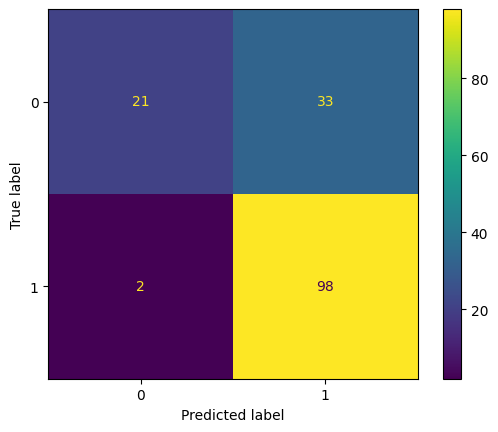

In [30]:
import matplotlib.pyplot as plt
cm= confusion_matrix(y_test,predictions)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

In [31]:
print(classification_report(y_test,predictions))

              precision    recall  f1-score   support

           0       0.91      0.39      0.55        54
           1       0.75      0.98      0.85       100

    accuracy                           0.77       154
   macro avg       0.83      0.68      0.70       154
weighted avg       0.81      0.77      0.74       154



GridSearchCV (Cross-validated Grid Search) is a method for systematically working through multiple combinations of hyperparameter values to find the best parameters for a given machine learning model. It is a part of the scikit-learn library in Python and is widely used for hyperparameter tuning.

In the context of machine learning, hyperparameters are configuration settings for a model that are not learned from the data but are set prior to training. The performance of a model can be highly dependent on the values chosen for these hyperparameters. GridSearchCV helps automate the process of hyperparameter tuning by evaluating the model's performance across a predefined grid of hyperparameter values.

In [32]:
#Hyperparameter Tuning (GridSearchCV)
from sklearn.model_selection import GridSearchCV

In [33]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

# Define the parameter grid for logistic regression
param_grid = {'C': [0.001, 0.01, 0.1, 1, 10, 100],
              'penalty': ['l1', 'l2'],
              'solver': ['liblinear', 'saga']}

# Create a logistic regression model
logistic_model = LogisticRegression()

# Assign the logistic regression parameters to GridSearchCV
grid_search = GridSearchCV(logistic_model, param_grid,
                           cv=5, n_jobs=-1,
                           verbose=1)

# Fit the data to the model
grid_search.fit(x_train, y_train)

# Choose the best parameters
print("The Best Parameters are", grid_search.best_params_)


Fitting 5 folds for each of 24 candidates, totalling 120 fits
The Best Parameters are {'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}


In [34]:
#Let's use the above parameters which we have received after Hyperparameter Tuning
model = LogisticRegression(penalty='l1',C=1,solver='liblinear')
model

LogisticRegression(C=1, penalty='l1', solver='liblinear')

In [35]:
model.fit(x_train,y_train)

LogisticRegression(C=1, penalty='l1', solver='liblinear')

In [36]:
#check for the predictions
log_predictions = model.predict(x_test)

In [37]:
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix

In [38]:
print("Accuracy Score",accuracy_score(y_test,log_predictions))

Accuracy Score 0.7727272727272727


In [39]:
print("Classification Report",classification_report(y_test,log_predictions))

Classification Report               precision    recall  f1-score   support

           0       0.91      0.39      0.55        54
           1       0.75      0.98      0.85       100

    accuracy                           0.77       154
   macro avg       0.83      0.68      0.70       154
weighted avg       0.81      0.77      0.74       154



In [40]:
print("Confusion Matrix \n",confusion_matrix(y_test,log_predictions))

Confusion Matrix 
 [[21 33]
 [ 2 98]]


In [41]:
#Let's check our Rootnode along with the Impurity(Gini Index) also will visualize the tree
x.columns

Index(['Gender', 'Married', 'Dependents', 'Education', 'Self_Employed',
       'ApplicantIncome', 'CoapplicantIncome', 'LoanAmount',
       'Loan_Amount_Term', 'Credit_History', 'Property_Area'],
      dtype='object')

In [42]:
x.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Gender             614 non-null    int32  
 1   Married            614 non-null    int32  
 2   Dependents         614 non-null    int32  
 3   Education          614 non-null    int32  
 4   Self_Employed      614 non-null    int32  
 5   ApplicantIncome    614 non-null    int64  
 6   CoapplicantIncome  614 non-null    float64
 7   LoanAmount         614 non-null    float64
 8   Loan_Amount_Term   614 non-null    float64
 9   Credit_History     614 non-null    int32  
 10  Property_Area      614 non-null    int32  
dtypes: float64(3), int32(7), int64(1)
memory usage: 36.1 KB


In [43]:
data.head()

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,1,0,0,0,0,5849,0.0,146.412162,360.0,1,2,1
1,1,1,1,0,0,4583,1508.0,128.000000,360.0,1,0,0
2,1,1,0,0,1,3000,0.0,66.000000,360.0,1,2,1
3,1,1,0,1,0,2583,2358.0,120.000000,360.0,1,2,1
4,1,0,0,0,0,6000,0.0,141.000000,360.0,1,2,1


In [44]:
#check the model with input sample
gender = int(input("Enter the Gender-->0/1 -->"))
applicant_income = int(input("Enter the Income:"))
coapplicant_income = float(input("Enter the Coapplicant Income:"))
loan_amount = float(input("Enter the Loan Amount:"))
term = float(input("Enter the Duration:"))
credit_history = int(input("Enter the Credit History -->0/1:"))
property_area = int(input("Enter the Type:"))
married = int(input("Enter the Marital Status:"))
dependents = int(input(""))
education = int(input(""))
self_employed = int(input(""))

Enter the Gender-->0/1 -->0
Enter the Income:1000
Enter the Coapplicant Income:10000
Enter the Loan Amount:1000000
Enter the Duration:2
Enter the Credit History -->0/1:1
Enter the Type:1
Enter the Marital Status:0
3
1
0


In [79]:
import numpy as np
#pass the above variables to create an array
user_input = np.array([[applicant_income,
                       coapplicant_income,loan_amount,term,
                        gender,married,dependents,education,self_employed,
                        credit_history,property_area,
                        ]])
#user_input
#let's check the prediction
prediction = model.predict(user_input)[0]
if prediction == 1:
    print("Loan will be Approved")
else:
    print("Loan is Rejected")

Loan will be Approved


## Now we will start increasing the samples within our dataframe -->SMOTE

In [46]:
#SMOTE -->Synthetic Minority Oversampling technique
!pip install -U imbalanced-learn

In [47]:
#scikit-learn == 1.2.2
from imblearn.over_sampling import SMOTE
oversampling = SMOTE() #generating synthetic data

In [48]:
x = data.drop('Gender', axis=1)
y = data['Gender']
#After creating the SMOTE object, you can use it to oversample your dataset.
#Typically, you would apply it to your features (x) and labels (y) using the fit_resample method:
x_oversample, y_oversample = oversampling.fit_resample(x, y)
data = pd.concat([pd.DataFrame(x_oversample),pd.DataFrame(y_oversample)],
                 axis=1)

data

,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status,Gender
0,0,0,0,0,5849,0.000000,146.412162,360.0,1,2,1,1
1,1,1,0,0,4583,1508.000000,128.000000,360.0,1,0,0,1
2,1,0,0,1,3000,0.000000,66.000000,360.0,1,2,1,1
3,1,0,1,0,2583,2358.000000,120.000000,360.0,1,2,1,1
4,0,0,0,0,6000,0.000000,141.000000,360.0,1,2,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
999,0,0,0,0,3131,0.000000,93.273330,360.0,1,1,1,0
1000,0,0,0,0,2420,479.682163,123.933746,360.0,1,1,0,0
1001,1,1,0,0,11736,0.000000,385.451501,360.0,0,1,0,0
1002,1,0,0,0,3191,2335.330740,149.974558,360.0,1,1,1,0


In [49]:
#in the same process we go for the rmng columns which are needed
data.shape

(1004, 12)

In [50]:
x = data.drop('Married', axis=1)
y = data['Married']
#After creating the SMOTE object, you can use it to oversample your dataset.
#Typically, you would apply it to your features (x) and labels (y) using the fit_resample method:
x_oversample, y_oversample = oversampling.fit_resample(x, y)
data = pd.concat([pd.DataFrame(x_oversample),pd.DataFrame(y_oversample)],
                 axis=1)

#data

In [51]:
x = data.drop('Dependents', axis=1)
y = data['Dependents']
#After creating the SMOTE object, you can use it to oversample your dataset.
#Typically, you would apply it to your features (x) and labels (y) using the fit_resample method:
x_oversample, y_oversample = oversampling.fit_resample(x, y)
data = pd.concat([pd.DataFrame(x_oversample),pd.DataFrame(y_oversample)],
                 axis=1)
data.shape

(3044, 12)

In [52]:
x = data.drop('Education', axis=1)
y = data['Education']
#After creating the SMOTE object, you can use it to oversample your dataset.
#Typically, you would apply it to your features (x) and labels (y) using the fit_resample method:
x_oversample, y_oversample = oversampling.fit_resample(x, y)
data = pd.concat([pd.DataFrame(x_oversample),pd.DataFrame(y_oversample)],
                 axis=1)
data.shape

(5598, 12)

In [53]:
x = data.drop('Self_Employed', axis=1)
y = data['Self_Employed']
#After creating the SMOTE object, you can use it to oversample your dataset.
#Typically, you would apply it to your features (x) and labels (y) using the fit_resample method:
x_oversample, y_oversample = oversampling.fit_resample(x, y)
data = pd.concat([pd.DataFrame(x_oversample),pd.DataFrame(y_oversample)],
                 axis=1)
data.shape

(10802, 12)

In [54]:
x = data.drop('Credit_History', axis=1)
y = data['Credit_History']
#After creating the SMOTE object, you can use it to oversample your dataset.
#Typically, you would apply it to your features (x) and labels (y) using the fit_resample method:
x_oversample, y_oversample = oversampling.fit_resample(x, y)
data = pd.concat([pd.DataFrame(x_oversample),pd.DataFrame(y_oversample)],
                 axis=1)
data.shape

(16380, 12)

In [55]:
x = data.drop('Property_Area', axis=1)
y = data['Property_Area']
#After creating the SMOTE object, you can use it to oversample your dataset.
#Typically, you would apply it to your features (x) and labels (y) using the fit_resample method:
x_oversample, y_oversample = oversampling.fit_resample(x, y)
data = pd.concat([pd.DataFrame(x_oversample),pd.DataFrame(y_oversample)],
                 axis=1)
data.shape

(24096, 12)

In [56]:
#finally transform the target variable also
x = data.drop('Loan_Status', axis=1)
y = data['Loan_Status']
#After creating the SMOTE object, you can use it to oversample your dataset.
#Typically, you would apply it to your features (x) and labels (y) using the fit_resample method:
x_oversample, y_oversample = oversampling.fit_resample(x, y)
data = pd.concat([pd.DataFrame(x_oversample),pd.DataFrame(y_oversample)],
                 axis=1)
data.shape

(33476, 12)

In [57]:
#Gender,Married,Dependents,Education,Self_Employed,
#Property_Area,Credit_History,Loan_Status
#In all above mentiond columns we have generated synthetic data
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33476 entries, 0 to 33475
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   ApplicantIncome    33476 non-null  int64  
 1   CoapplicantIncome  33476 non-null  float64
 2   LoanAmount         33476 non-null  float64
 3   Loan_Amount_Term   33476 non-null  float64
 4   Gender             33476 non-null  int32  
 5   Married            33476 non-null  int32  
 6   Dependents         33476 non-null  int32  
 7   Education          33476 non-null  int32  
 8   Self_Employed      33476 non-null  int32  
 9   Credit_History     33476 non-null  int32  
 10  Property_Area      33476 non-null  int32  
 11  Loan_Status        33476 non-null  int32  
dtypes: float64(3), int32(8), int64(1)
memory usage: 2.0 MB


In [58]:
#We will visulize using Plotly Graphs then will remove the
#outliers in Income columns -->No Free Lunch Theorem

In [59]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [60]:
import plotly.express as px
import plotly.graph_objects as go

In [61]:
#Checking for the Marital Status Distribution
px.pie(data,names="Married",title="Marital Status Distribution")

In [62]:
#Dependents wise Distribution
px.histogram(data,x = "Dependents",
             title="Dependents Count")

In [63]:
#Box and Whisker Plot distribution
px.box(data) #we can observe outliers in applicant and co-applicant income

In [64]:
#Let's check for the outliers within the dataframe
#below function will return the outlier percentage within
#given column
def remove_outliers_and_percentage(data, col,
                                   threshold = 1.5):
    Q1 = data[col].quantile(0.25)
    Q3 = data[col].quantile(0.75)
    IQR = Q3 - Q1 #InterQuantile Rang
    #defining the lower and upper bounds
    lower_bound = Q1 - threshold * IQR
    upper_bound = Q3 + threshold * IQR
    #Filter the DataFrame to keep only the rows where the
    #column values are within the calculated bounds,
    #effectively removing outliers
    data_no_outliers = data[(data[col] >= lower_bound) &
                            (data[col] <= upper_bound)]
    percentage_outliers = ((len(data) - len(data_no_outliers))
                           / len(data)) * 100
    return data_no_outliers, percentage_outliers

In [65]:
data.columns

Index(['ApplicantIncome', 'CoapplicantIncome', 'LoanAmount',
       'Loan_Amount_Term', 'Gender', 'Married', 'Dependents', 'Education',
       'Self_Employed', 'Credit_History', 'Property_Area', 'Loan_Status'],
      dtype='object')

In [66]:
#let's check the outlier percentage in both Applicant and Co-Applicant Income columns
cleaned_data,outlier_percentage = remove_outliers_and_percentage(data,"ApplicantIncome")
outlier_percentage

12.964511889114588

In [67]:
cleaned_data,outlier_percentage = remove_outliers_and_percentage(data,"CoapplicantIncome")
outlier_percentage

2.781096905245549

In [68]:
#We can remove those minor percentage outliers in those two columns or we can
#go ahead with the generated data

In [69]:
x = data.drop('Loan_Status',axis=1)
y = data['Loan_Status']

In [70]:
#divide the data into training and testing
x_train,x_test,y_train,y_test = train_test_split(x,y,
                                                test_size=0.2,
                                                random_state=42)

In [71]:
#We will apply multiple models and choose the best one
#Logistic Regression,DecisionTree,RandomForest (Ensemble)
from sklearn.linear_model import LogisticRegression
#from sklearn.tree import DecisionTreeClassifier
#from sklearn.ensemble import RandomForestClassifier

In [72]:
#start building the models,fit the data and check the metrics
#Logistic Regression
log_model = LogisticRegression()
log_model.fit(x_train,y_train)
log_model_predictions = log_model.predict(x_test)
#DecisionTreeClassifier
#dtree = DecisionTreeClassifier()
#dtree.fit(x_train,y_train)
#dtree_predictions = dtree.predict(x_test)
#RandomForestClassifier
#rf_model = RandomForestClassifier()
#rf_model.fit(x_train,y_train)
#rf_model_predictions = rf_model.predict(x_test)

In [73]:
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score,confusion_matrix

#define a function for all the metrics
def evaluate_model(predictions,y_true):
    accuracy=accuracy_score(y_true,predictions)
    precision = precision_score(y_true,predictions)
    recall = recall_score(y_true,predictions)
    f1_sc = f1_score(y_true,predictions)
    c_mat = confusion_matrix(y_true,predictions)
    return accuracy,precision,recall,f1_sc,c_mat

In [74]:
#Based on above function will check metricsfor all 3 models
print("Logistic Regression Metrics: \n")
logistic_metrics = evaluate_model(log_model_predictions,y_test)
print(logistic_metrics)

Logistic Regression Metrics: 

(0.8585722819593787, 0.8023051866700075, 0.9529761904761904, 0.8711739899333424, array([[2547,  789],
       [ 158, 3202]], dtype=int64))


In [75]:
x.head()

,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Gender,Married,Dependents,Education,Self_Employed,Credit_History,Property_Area
0,5849,0.0,146.412162,360.0,1,0,0,0,0,1,2
1,4583,1508.0,128.000000,360.0,1,1,1,0,0,1,0
2,3000,0.0,66.000000,360.0,1,1,0,0,1,1,2
3,2583,2358.0,120.000000,360.0,1,1,0,1,0,1,2
4,6000,0.0,141.000000,360.0,1,0,0,0,0,1,2


In [76]:
data.head()

,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Gender,Married,Dependents,Education,Self_Employed,Credit_History,Property_Area,Loan_Status
0,5849,0.0,146.412162,360.0,1,0,0,0,0,1,2,1
1,4583,1508.0,128.000000,360.0,1,1,1,0,0,1,0,0
2,3000,0.0,66.000000,360.0,1,1,0,0,1,1,2,1
3,2583,2358.0,120.000000,360.0,1,1,0,1,0,1,2,1
4,6000,0.0,141.000000,360.0,1,0,0,0,0,1,2,1


In [77]:
#Finally we got RandomForest as the best model so we go creating a pickle file
gender = int(input("Enter the Gender-->0/1:"))
applicant_income = float(input("Enter the Income:"))
coapplicant_income = float(input("Enter the Coapplicant Income:"))
loan_amount = float(input("Enter the Loan Amount:"))
term = float(input("Enter the Duration:"))
credit_history = int(input("Enter the Credit History -->0/1:"))
property_area = int(input("Enter the Type:"))
married = int(input("Enter the Marital Status:"))
dependents = int(input("Dependents:"))
education = int(input("Education:"))
self_employed = int(input("Self_Employed:"))

Enter the Gender-->0/1:1
Enter the Income:100000
Enter the Coapplicant Income:100000
Enter the Loan Amount:100000
Enter the Duration:2
Enter the Credit History -->0/1:1
Enter the Type:1
Enter the Marital Status:1
Dependents:2
Education:1
Self_Employed:0


In [80]:
user_input = np.array([[applicant_income,
                       coapplicant_income,loan_amount,term,
                        gender,married,dependents,education,self_employed,
                        credit_history,property_area,
                        ]])
print(user_input)
prediction = log_model.predict(user_input)[0]
print(prediction)
if prediction == 1:
    print("Loan will be Approved")
else:
    print("Loan is Rejected")

[[1.e+05 1.e+05 1.e+05 2.e+00 1.e+00 1.e+00 2.e+00 1.e+00 0.e+00 1.e+00
  1.e+00]]
0
Loan is Rejected


In [81]:
import pickel as pl


ModuleNotFoundError: No module named 'pickel'

In [82]:
pip install pickel

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement pickel (from versions: none)
ERROR: No matching distribution found for pickel


In [83]:
import pickle

In [85]:
pickle.dump(log_model,open('lin_model.pkl','wb'))

SyntaxError: invalid syntax (3940060500.py, line 1)